<a href="https://colab.research.google.com/github/SteveCoss/SWOTdawgDISTRO/blob/main/ExploreDatasets.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# How to download
The notebooks and the datasets, including an up-to-date version of swotdawgviz can be downloaded using this link: https://filesender.renater.fr/?s=download&token=2dee442e-4b37-41be-83d6-ae22aa8378a2

# Notebook to explore SWOT algorithm input datasets

The input datasets are 1) the SWORD dataset (the prior database); 2) the SWOT data; 3) the so-called SWORD of science (SoS)

In [1]:
import os, sys
from google.colab import drive
drive.mount('/content/drive')
nb_path = '/content/notebooks'
os.symlink('/content/drive/My Drive/DAWGnotebooks/Path_files', nb_path)
sys.path.insert(0,nb_path)

Mounted at /content/drive


In [2]:
#reset working directory to distro folder
!pwd
import os
os.chdir("/content/drive/My Drive/DAWGnotebooks/dist_4.1")
!pwd

/content
/content/drive/My Drive/DAWGnotebooks/dist_4.1


In [3]:
import os,sys

import json
from pathlib import Path
import geopandas as gpd
from netCDF4 import Dataset
import numpy as np
import folium

# Register pandas converters for matplotlib
from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()

import matplotlib.pyplot as plt

This notebook relies on the swotdawgviz library. Use either the version included in this package or use an up-to-date version (https://github.com/klarnier/swotdawgviz)

In [4]:
# Using embedded version of swotdawgviz
from swotdawgviz.swotdawgviz import io as sdvio
from swotdawgviz.swotdawgviz import maps as sdvm

# # Using installed version of swotdawgviz
# from swotdawgviz import io as sdvio
# from swotdawgviz import maps as sdvm

This library is supposed to run on a Jupyter notebook. Please be aware that some method may not work


## Explore SWORD

Here we'll check out the SWORD data. We'll create a quick map of the domain showing the reach centerlines, then create a map with reaches colored by width. 

In [5]:
InputDir=Path('.')
swotdir=InputDir.joinpath('swot')
swot_nc_dir=swotdir.joinpath('timeseries')

sword_dir=InputDir.joinpath('sword')
sword_shp_dir=sword_dir.joinpath('shp').joinpath('NA')

collection = sdvio.SwotObservationsCollection(swot_nc_dir)

sword_hb74_reaches = sdvio.SwordShapefile(sword_shp_dir.joinpath("na_sword_reaches_hb74_v11.shp"),
                                          reaches_list=collection.reaches_list)


In [6]:
rmap = sdvm.ReachesMap(sword_hb74_reaches.dataset)
ridmap = rmap.get_centerlines_map()
ridmap

In [7]:
# the swotdawgviz library is also set up to create maps with reaches (or nodes) colored by attributes
widthmap = rmap.get_centerlines_map(varname="width")
widthmap

In [8]:
# in fact,  swotdawgviz library can even create polygons for the reaches, with width shown by polygon size
# zoom in to check out what's going on!
widthpolymap = rmap.get_polygons_map(varname="width", width_attribute="width")
widthpolymap

In [9]:
# you can visualize pretty much any SWORD characteristic this way
faccmap = rmap.get_centerlines_map(varname="facc",varlimits=[11000,1e6])
faccmap

## Explore SWOT Data

First, show an example swath in the domain, and then look at some of the data products from that swath

In [10]:
# show an example swath in the domain

#read orbit data for one pass, 175, and show coverage
orbitdir=swotdir.joinpath('orbit')
orbitfile=orbitdir.joinpath('swot_science_orbit_sept2015-v2_10s_swath.shp')
df = gpd.read_file(orbitfile)

swathmap = folium.Map(
    location=[38.5, -85],
    tiles='Stamen Toner',
    zoom_start=6.5)

for _, r in df.iterrows():
    if r['ID_PASS']==175:    
        sim_geo = gpd.GeoSeries(r['geometry']).simplify(tolerance=0.001)
        geo_j = sim_geo.to_json()
        geo_j = folium.GeoJson(data=geo_j,
                               style_function=lambda x: {'fillColor': 'orange'})
        folium.Popup(r['ID_PASS']).add_to(geo_j)
        geo_j.add_to(swathmap)

swathmap

In [11]:
# show the node WSE measurements for first cycle of this pass which I _think_ is 428 in the new convention 

obsfile=swotdir.joinpath('RiverSP').joinpath('SWOT_L2_HR_RiverSP_node_1_428_NA_20100830T061857_20100830T061920_PGA2_03.shp')
dfobs = gpd.read_file(obsfile)

nmap = sdvm.NodesMap(dfobs)
obsnodes = nmap.get_map(varname="wse", add_to_map=swathmap)

# folium.GeoJson(data=dfobs['geometry'],
#                marker=folium.CircleMarker(location=None, radius = 3, # Radius in metres
#                                            weight = 0, #outline weight
#                                            fill_color = '#0000FF', 
#                                            fill_opacity = 1),).add_to(swathmap)

swathmap

In [12]:
# plot up all the node WSE data for the Ohio River, from this pass
# TODO change axis labels to make pretty etc. make pdistout human readable

# read in file with all reaches in the domain
reach_json=InputDir.joinpath('reaches.json')
with open(reach_json) as json_file:
    reaches = json.load(json_file)

#extract reach ids
domain_reachids=list()
for reach in reaches:
    domain_reachids.append(reach['reach_id'])

# read data from sword file
swordfile=sword_dir.joinpath('netcdf').joinpath('na_sword_v11.nc')
sword_dataset=Dataset(swordfile)

sword_point_reachids=sword_dataset['centerlines/reach_id'][0,:][:]
swordx=sword_dataset['centerlines/x'][:]
swordy=sword_dataset['centerlines/y'][:]

swordreachids=sword_dataset["reaches/reach_id"][:].tolist()
sword_names=sword_dataset['reaches/river_name'][:]
sword_drainage_area=sword_dataset['reaches/facc'][:]
sword_swot_orbits=sword_dataset['reaches/swot_orbits'][:]

# create sword data dictionary for domain
domain_reach_data={}

for reach in domain_reachids:
    
    # deal with points
    indxs=np.argwhere(sword_point_reachids.data==reach)   
    indxs=indxs[:,0]
    points=[]
    for indx in indxs:           
        points.append(tuple([swordy[indx],swordx[indx]]))    
        
    # deal with reaches
    indx = swordreachids.index(reach)
    
    domain_reach_data[reach]={}
    domain_reach_data[reach]['clpoints']=points
    domain_reach_data[reach]['river_name']=sword_names[indx]
    domain_reach_data[reach]['drainage_area_km2']=sword_drainage_area[indx]
    domain_reach_data[reach]['swot_orbits']=sword_swot_orbits[:,indx]

# grab river name for each node
node_river_name=list()
for _, r in dfobs.iterrows():
    if int(r['reach_id']) in domain_reach_data:
        node_river_name.append(domain_reach_data[int(r['reach_id'])]['river_name'])
    else:
        node_river_name.append('N/A')
        
dfobs['river_name']=node_river_name
dfobs.head()

dfobs_ohio =  dfobs.loc[ (dfobs['river_name'] == 'Ohio River') & (dfobs['wse'] != -9999) ]

dfobs_ohio

,reach_id,node_id,time,time_tai,time_str,lat,lon,lat_u,lon_u,wse,...,p_wse_var,p_width,p_wid_var,p_dist_out,p_length,p_dam_id,p_n_ch_max,p_n_ch_mod,geometry,river_name
0,74267400011,74267400010021,3.364644e+08,-9999,-9999,38.683099,-85.184293,-9999,-9999,127.509296,...,0.000000,67.0,0.0000,2.358472e+06,180.000000,-9999,1,1,POINT (-85.18429 38.68310),Ohio River
1,74267400011,74267400010031,3.364643e+08,-9999,-9999,38.681342,-85.184337,-9999,-9999,127.407505,...,0.263472,67.0,0.0000,2.358682e+06,210.000000,-9999,1,1,POINT (-85.18434 38.68134),Ohio River
2,74267400011,74267400010041,3.364643e+08,-9999,-9999,38.679451,-85.184385,-9999,-9999,128.029372,...,0.019284,67.0,0.0000,2.358892e+06,210.000000,-9999,1,1,POINT (-85.18438 38.67945),Ohio River
3,74267400011,74267400010051,3.364643e+08,-9999,-9999,38.677694,-85.184429,-9999,-9999,127.729397,...,0.000000,67.0,0.0000,2.359072e+06,180.000000,-9999,1,1,POINT (-85.18443 38.67769),Ohio River
4,74267400011,74267400010061,3.364643e+08,-9999,-9999,38.675938,-85.184474,-9999,-9999,127.604710,...,0.000000,67.0,0.0000,2.359282e+06,210.000000,-9999,1,1,POINT (-85.18447 38.67594),Ohio River
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2271,74267700051,74267700050481,3.364644e+08,-9999,-9999,38.940822,-84.279242,-9999,-9999,138.616293,...,0.000000,551.0,0.0000,2.500608e+06,212.132260,-9999,1,1,POINT (-84.27924 38.94082),Ohio River
2272,74267700051,74267700050491,3.364644e+08,-9999,-9999,38.939431,-84.277564,-9999,-9999,138.762813,...,0.000000,551.0,0.0000,2.500820e+06,212.132260,-9999,1,1,POINT (-84.27756 38.93943),Ohio River
2273,74267700051,74267700050501,3.364644e+08,-9999,-9999,38.938180,-84.276055,-9999,-9999,138.727933,...,0.000000,572.0,82.6875,2.500985e+06,165.698133,-9999,1,1,POINT (-84.27605 38.93818),Ohio River
2274,74267700051,74267700050511,3.364644e+08,-9999,-9999,38.936933,-84.274753,-9999,-9999,138.732122,...,0.000000,551.0,70.5600,2.501181e+06,196.101562,-9999,1,1,POINT (-84.27475 38.93693),Ohio River


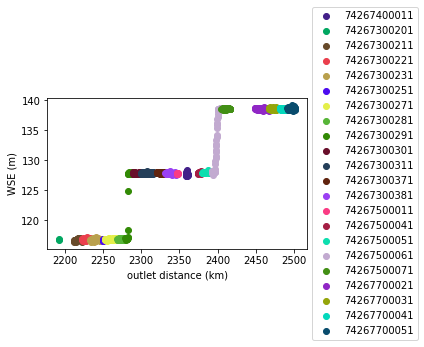

In [13]:
rids=dfobs_ohio.reach_id.unique()

import random

fig,ax=plt.subplots()

for rid in rids:
    hexcolor = ["#"+''.join([random.choice('ABCDEF0123456789') for i in range(6)])]
    
    reach_data = dfobs_ohio.loc[dfobs_ohio.reach_id==rid]
    ax.scatter(reach_data["p_dist_out"] * 0.001, reach_data["wse"], c=hexcolor, label=rid)
    
plt.legend(loc='center left', bbox_to_anchor=(1.0, .5))
ax.set_xlabel("outlet distance (km)")
ax.set_ylabel("WSE (m)")
plt.tight_layout()
plt.show()


## Explore SOS
First, take a look at the flow duration curves  / compare the WBM and GRADES priors. There is a ton of information in SoS: take a look at the fluvial geomorph quantities. Then take a look at gage locations. 

In [14]:
sosdir=InputDir.joinpath('sos')
sosfile_con=sosdir.joinpath('constrained').joinpath('na_sword_v11_SOS_priors.nc')
sosfile_uncon=sosdir.joinpath('unconstrained').joinpath('na_sword_v11_SOS_priors.nc')
sos_con = sdvio.SosNetCDF(sosfile_con)
sos_uncon = sdvio.SosNetCDF(sosfile_uncon)

6 variables extracted in model (GRADES) group
39 variables extracted in gbpriors/reach group
7 variables extracted in grdc group
6 variables extracted in usgs group
5 variables extracted in model (GRADES) group
39 variables extracted in gbpriors/reach group


In [15]:
sos_con.dataset

,reach_id,model_max_q,model_mean_q,model_min_q,model_two_year_return_q,model_area_estimate_flag,model_comid,gbpriors_river_type,gbpriors_lowerbound_A0,gbpriors_upperbound_A0,...,grdc_mean_q,grdc_min_q,grdc_two_year_return_q,grdc_id,num_usgs_reaches,usgs_reach_id,usgs_max_q,usgs_mean_q,usgs_min_q,usgs_two_year_return_q
0,71120000011,1001.858704,64.471458,0.569994,474.258392,0.0,71000138.0,1,1.47,114499.999774,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,71120000023,NaN,NaN,NaN,NaN,NaN,NaN,1,1.47,114499.999774,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,71120000031,1001.858704,64.471458,0.569994,474.258392,0.0,71000138.0,1,1.47,114499.999774,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,71120000041,1001.858704,64.471458,0.569994,474.258392,0.0,71000138.0,1,1.47,114499.999774,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,71120000051,874.542786,59.491611,0.545305,446.913910,0.0,71000139.0,1,1.47,114499.999774,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37660,91450100146,NaN,NaN,NaN,NaN,NaN,NaN,1,1.47,114499.999774,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
37661,91450100156,NaN,NaN,NaN,NaN,NaN,NaN,1,1.47,114499.999774,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
37662,91450100166,NaN,NaN,NaN,NaN,NaN,NaN,1,1.47,114499.999774,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
37663,91490000011,607.025772,38.499662,0.203446,310.317644,1.0,44044160.0,1,1.47,114499.999774,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [16]:
list(sos_con.dataset.columns)

['reach_id',
 'model_max_q',
 'model_mean_q',
 'model_min_q',
 'model_two_year_return_q',
 'model_area_estimate_flag',
 'model_comid',
 'gbpriors_river_type',
 'gbpriors_lowerbound_A0',
 'gbpriors_upperbound_A0',
 'gbpriors_lowerbound_logn',
 'gbpriors_upperbound_logn',
 'gbpriors_lowerbound_b',
 'gbpriors_upperbound_b',
 'gbpriors_lowerbound_logWb',
 'gbpriors_upperbound_logWb',
 'gbpriors_lowerbound_logDb',
 'gbpriors_upperbound_logDb',
 'gbpriors_lowerbound_logr',
 'gbpriors_upperbound_logr',
 'gbpriors_logA0_hat',
 'gbpriors_logn_hat',
 'gbpriors_b_hat',
 'gbpriors_logWb_hat',
 'gbpriors_logDb_hat',
 'gbpriors_logr_hat',
 'gbpriors_logA0_sd',
 'gbpriors_logn_sd',
 'gbpriors_b_sd',
 'gbpriors_logWb_sd',
 'gbpriors_logDb_sd',
 'gbpriors_logr_sd',
 'gbpriors_lowerbound_logWc',
 'gbpriors_upperbound_logWc',
 'gbpriors_lowerbound_logQc',
 'gbpriors_upperbound_logQc',
 'gbpriors_logWc_hat',
 'gbpriors_logQc_hat',
 'gbpriors_logQ_sd',
 'gbpriors_logWc_sd',
 'gbpriors_logQc_sd',
 'gbpriors

In [17]:
# create a map of GRADES two-year return Q

# add GRADES two-year discharge to the rmap object
rmap._dataset['GRADES_2yr']=-1.

for reachid in domain_reachids:
    
    reach_data = sos_con.dataset.loc[sos_con.dataset['reach_id']==reachid]
    
    if "grades_two_year_return_q" in reach_data.columns:
        #--------------------------------
        # EMBEDDED VERSION OF swotdawgviz
        #--------------------------------
        grades_two_year_return_q = reach_data['grades_two_year_return_q'].values[0]

    else:
        #--------------------------------
        # UP-TO-DATE VERSION OF swotdawgviz
        #--------------------------------
        grades_two_year_return_q = reach_data['model_two_year_return_q'].values[0]
        
    
    rmap._dataset.loc[rmap._dataset['reach_id'].astype(str)==str(reachid),['GRADES_2yr']]=grades_two_year_return_q
    

rmap._json_dataset = rmap._dataset.to_json()    



In [18]:
Grades2yr_map = rmap.get_centerlines_map(varname="GRADES_2yr",varlimits=[1000,15000])
Grades2yr_map

In [19]:
# create a map of A0 prior
rmap._dataset['A0prior']=-1.

for reachid in domain_reachids:
    
    reach_data = sos_con.dataset.loc[sos_con.dataset['reach_id']==reachid]
    gbpriors_logA0_hat = reach_data['gbpriors_logA0_hat'].values[0]
    
    rmap._dataset.loc[rmap._dataset['reach_id'].astype(str)==str(reachid),['A0prior']]=np.exp(gbpriors_logA0_hat)
    

rmap._json_dataset = rmap._dataset.to_json()    

A0hat_map = rmap.get_centerlines_map(varname="A0prior",varlimits=[10,1000])
A0hat_map

In [20]:
rmap._dataset

,x,y,reach_id,reach_len,n_nodes,wse,wse_var,width,width_var,facc,...,n_rch_dn,rch_id_up,rch_id_dn,swot_orbit,swot_obs,type,river_name,geometry,GRADES_2yr,A0prior
1871,-89.625678,36.183383,74259000031,10220.268368,51,75.200005,0.187897,1272.0,204319.815847,2.361880e+06,...,1,74259000041,74259000021,509,1,1,Mississippi River,"LINESTRING (-89.59233 36.14982, -89.59241 36.1...",32926.445312,254.249877
1872,-89.666780,36.238610,74259000041,10197.820130,51,76.300003,0.255319,750.0,25358.762541,2.361654e+06,...,1,74259000051,74259000031,509,1,1,Mississippi River,"LINESTRING (-89.66996 36.21112, -89.67030 36.2...",32929.769531,254.249877
1873,-89.581138,36.253540,74259000051,10175.465710,51,77.200005,0.183451,1029.0,423863.074469,2.361415e+06,...,1,74259000061,74259000041,509,1,1,Mississippi River,"LINESTRING (-89.62493 36.24142, -89.62459 36.2...",32924.390625,254.249877
1874,-89.604184,36.315973,74259000061,10207.867362,51,78.300003,0.246779,567.0,42091.580898,2.361178e+06,...,1,74259000071,74259000051,509,1,1,Mississippi River,"LINESTRING (-89.56993 36.28453, -89.57027 36.2...",32927.781250,254.249877
1875,-89.539441,36.379462,74259000071,19557.370048,98,79.099998,0.356578,1310.0,193004.520669,2.360949e+06,...,1,74259000081,74259000061,216 509,2,1,Mississippi River,"LINESTRING (-89.59732 36.34504, -89.59698 36.3...",32935.238281,254.249877
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3380,-89.513515,37.539566,74270100231,8397.185454,42,100.599998,0.003280,700.0,4634.624152,1.823844e+06,...,1,74270500011 74270400011,74270100221,216 509,2,1,Mississippi River,"LINESTRING (-89.49614 37.50425, -89.49622 37.5...",12140.629883,254.249877
3390,-89.521655,37.650814,74270500011,18647.964655,93,102.300003,0.686407,637.0,11348.669527,1.823681e+06,...,1,74270500021,74270100231,216 231 509,3,1,Mississippi River,"LINESTRING (-89.52092 37.57482, -89.52126 37.5...",12139.854492,254.249877
3391,-89.643722,37.755354,74270500021,18753.515809,94,104.000000,0.154930,653.5,18983.888758,1.816453e+06,...,1,74270500031,74270500011,216 231 509,3,1,Mississippi River,"LINESTRING (-89.56757 37.70650, -89.56791 37.7...",11979.547852,254.249877
3392,-89.735245,37.843938,74270500031,8866.360414,44,106.000000,0.055285,770.5,19243.695816,1.809672e+06,...,1,74270500041,74270500021,216 231,2,1,Mississippi River,"LINESTRING (-89.69984 37.81643, -89.70018 37.8...",11977.714844,254.249877


In [21]:
# create a map of GRADES meanQ

# add GRADES two-year discharge to the rmap object
rmap._dataset['grades_mean_q']=-1.

for reachid in domain_reachids:
    rmap._dataset.loc[rmap._dataset['reach_id'].astype(str)==str(reachid),['grades_mean_q']]=sos_con.dataset.loc[sos_con.dataset['reach_id']==reachid]['model_mean_q'].values[0]
    

rmap._json_dataset = rmap._dataset.to_json()    



In [22]:
GradesmeanQ_map = rmap.get_centerlines_map(varname="grades_mean_q",varlimits=[500,15000])
GradesmeanQ_map

In [23]:
# create a map of WBM meanQ

# add GRADES two-year discharge to the rmap object
rmap._dataset['WBM_mean_q']=-1.

for reachid in domain_reachids:
    rmap._dataset.loc[rmap._dataset['reach_id'].astype(str)==str(reachid),['WBM_mean_q']]=sos_uncon.dataset.loc[sos_uncon.dataset['reach_id']==reachid]['model_mean_q'].values[0]
    

rmap._json_dataset = rmap._dataset.to_json()    
WBMmeanQ_map = rmap.get_centerlines_map(varname="WBM_mean_q",varlimits=[500,15000])
WBMmeanQ_map

In [29]:
# plot up gage locations
nrtfile=InputDir.joinpath('sos/gages/NRT_V3.csv')

nrtdf = gpd.read_file(nrtfile)
nrtdf.crs = 'epsg:4326'
nrtdf.geometry=gpd.points_from_xy(nrtdf.X, nrtdf.Y)
nrtdfCAL=nrtdf[nrtdf.CAL.astype('int32')==1]
nrtdfVAL=nrtdf[nrtdf.CAL.astype('int32')==0]


#--------------------------------
# EMBEDDED VERSION OF swotdawgviz
#--------------------------------
# folium.GeoJson(data=nrtdf['geometry'],
#                marker=folium.CircleMarker(radius = 3, # Radius in metres
#                                            weight = 0, #outline weight
#                                            fill_color = '#0000FF', 
#                                            fill_opacity = 1),).add_to(ridmap)

#----------------------------------
# UP-TO-DATE VERSION of swotdawgviz
#----------------------------------
# Use circle shape for performance !
gmapC = sdvm.GagesMap(nrtdfCAL)
gmapV = sdvm.GagesMap(nrtdfVAL)
gagesmapC = gmapC.get_map(varname_id=None, shape="circle", add_to_map=ridmap)
gagesmapV = gmapV.get_map(varname_id=None, shape="marker", add_to_map=ridmap)
ridmap